In [1]:
import csv
import numpy as np

In [3]:
predicted = 'predicted_densenet_tokwotal.csv' #'predicted.csv'
names = 'TokWotal_test.csv' #'waterwind_test.csv'
class0 = 'wmratio-00.00' #metal
class1 = 'wmratio-01.00' #wood

In [4]:
data = open(names,'r').readlines()
namelist = []
classcolors = []
paramcolors = []
for row in data[1:]:
    name = row.split(',')[0]
    namelist.append(name)
    if class0 in name:
        # print(name)
        # param = float(name.split('--')[2].split('-')[1].replace('.wav','')) #busybody
        param = float(name.split('--')[2].split('-')[1]) # cf
        classcolors.append(0)
        paramcolors.append(int(param*10))
        
    else:
        param = float(name.split('--')[2].split('-')[1])
        classcolors.append(1)
        paramcolors.append(int(param*10)) 
print(np.shape(namelist))
# print(namelist)

(220,)


In [5]:
data = csv.reader(open(predicted,'r'))
subset_len = 1920
for_pca = np.array([])
for row in data:
    row_sub = row[:subset_len]
    if for_pca.size:
        for_pca = np.vstack((for_pca,np.array(row_sub)))
    else:
        for_pca = np.array(row_sub)
print(np.shape(for_pca))

(220, 1920)


In [6]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(for_pca)
print(np.shape(principalComponents[:,0]))

(220,)


Text(0.5, 0.92, 'Principal Components of 1920 outputs of VGGish')

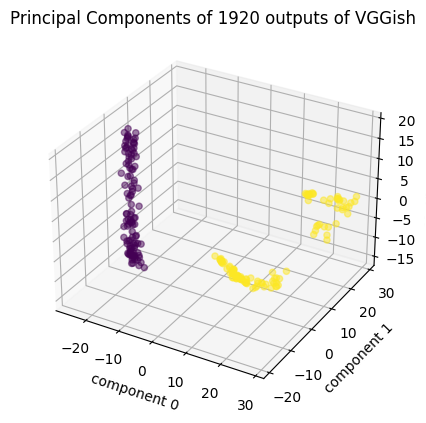

In [7]:
import matplotlib.pylab as plt
ax = plt.axes(projection='3d')
scatter = ax.scatter3D(principalComponents[:,0], principalComponents[:,1], principalComponents[:,2],c=classcolors,alpha=0.5)
plt.xlabel('component 0')
plt.ylabel('component 1')
ax.set_zlabel('component 2')
plt.title('Principal Components of 1920 outputs of VGGish')

This is the PCA projection onto 3 dimensions of the 1920 dimensions of the output of the VGGish layers of the audio classifier, after retraining with our water-wind data.
Color-code: 'Purple' - Metal ; 'Yellow' - Wood

Text(0.5, 0.92, 'Principal Components of 1920 outputs of VGGish')

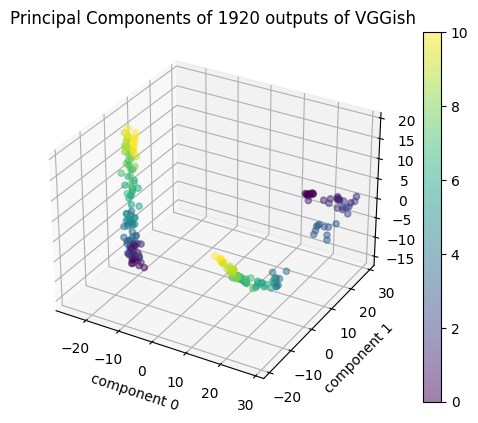

In [8]:
ax = plt.axes(projection='3d')
scatter = ax.scatter3D(principalComponents[:,0], principalComponents[:,1], principalComponents[:,2],c=paramcolors,alpha=0.5)
plt.colorbar(scatter)
plt.xlabel('component 0')
plt.ylabel('component 1')
ax.set_zlabel('component 2')
plt.title('Principal Components of 1920 outputs of VGGish')

This is the same PCA projection as the previous figure, but color-coded based on the semantics within each class, i.e.
Color-code: 'Purple' to 'Yellow' means rate parameter of metal hits are going from low to high for metal cluster, and rate parameter going from low to high for the wood cluster.

Clearly, component 0 defines the class, component 1 defines parameter variation in metal class, component 2 deines parameter variation in wood class.

Text(0.5, 1.0, 'Principal Components of 1920 outputs of VGGish')

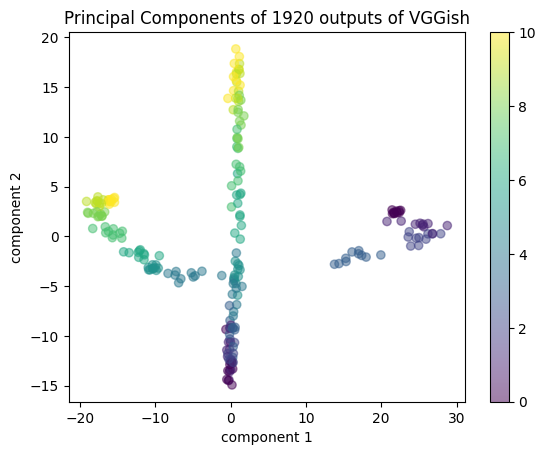

In [9]:
ax = plt.axes()
scatter = ax.scatter(principalComponents[:,1], principalComponents[:,2],c=paramcolors,alpha=0.5)
plt.colorbar(scatter)
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.title('Principal Components of 1920 outputs of VGGish')

Cross-sectional view of the previous 3d plot

In [43]:
# TSNE

In [40]:
# from sklearn.manifold import TSNE
# n_components = 3
# tsne = TSNE(n_components,init='pca')
# tsneComponents = tsne.fit_transform(for_pca)
# print(np.shape(tsneComponents))

# import matplotlib.pylab as plt
# ax = plt.axes(projection='3d')
# scatter = ax.scatter3D(tsneComponents[:,0], tsneComponents[:,1], tsneComponents[:,2],c=classcolors,alpha=0.5)
# plt.xlabel('component 0')
# plt.ylabel('component 1')
# ax.set_zlabel('component 2')
# plt.title('Principal Components of 1920 outputs of VGGish')


In [41]:

# ax = plt.axes(projection='3d')
# scatter = ax.scatter3D(tsneComponents[:,0], tsneComponents[:,1], tsneComponents[:,2],c=paramcolors,alpha=0.5)
# plt.colorbar(scatter)
# plt.xlabel('component 0')
# plt.ylabel('component 1')
# ax.set_zlabel('component 2')
# plt.title('Principal Components of 1920 outputs of VGGish')

In [42]:
# ax = plt.axes()
# scatter = ax.scatter(tsneComponents[:,0], tsneComponents[:,1],c=paramcolors,alpha=0.5)
# plt.colorbar(scatter)
# plt.xlabel('component 0')
# plt.ylabel('component 1')
# plt.title('Principal Components of 1920 outputs of VGGish')

In [13]:
# # Update Gan json file
# import json
# ganjsonfile = 'nsjson_modified_softclasslabels.json'
# output = 'nsjson_softclasslabels_pca.json'
# ganjson = json.load(open(ganjsonfile,'r'))
# for i in range(len(namelist)):
#     audio = namelist[i].replace('.wav','')
#     ganjson[audio]['pca_0'] = round(principalComponents[i,0],2)
#     ganjson[audio]['pca_1'] = round(principalComponents[i,1],2)
#     ganjson[audio]['pca_2'] = round(principalComponents[i,2],2)

# json.dump(ganjson,open(output,'w'),sort_keys=True, indent=4)

In [14]:
def ReorderNames(elem):
    return int(elem.split('_')[-1].replace('.wav',''))

In [15]:
import glob
import soundfile as sf
import librosa
def GetMergedAudioFile(folder,audio):
    filelist = glob.glob(folder+'/*.wav')
    filelist.sort(key=ReorderNames)
    # print(filelist)
    dataarray = np.array([])
    fs = 16000
    sublen = 1.5 #seconds
    silence = 0.2 #seconds
    sil_arr = [0]*int(silence*fs)
    
    for filename in filelist:
        x, sr = librosa.load(filename,duration=sublen, sr = fs)
        dataarray = np.append(dataarray,x)
        dataarray = np.append(dataarray,sil_arr)
    sf.write(audio,dataarray,sr,subtype='PCM_16')

In [16]:
import warnings
warnings.filterwarnings("ignore")
def showSpecgram(audio,text):
    FS=16000
    plt.figure()
    data,fs = librosa.load(audio,sr = FS)
    spec = plt.specgram(data, Fs=FS, NFFT=1024, cmap="rainbow")
    # plt.xlabel("Time (s)",fontsize=20)
    # plt.ylabel("Frequency",fontsize=20)
    # print(np.shape(spec[0]),len(xvals))
    plt.xticks([])
    plt.yticks([])
    # plt.xticks(fontsize=15) #,labels=xvals)
    # plt.yticks(fontsize=15)
    plt.ylim(0,8000)
    plt.xlabel(text+' varying -->')
    plt.tight_layout()
    # plt.show()

# GAN Synthesis with pca_0, pca_1, and pca_2 as conditioning values

Now we train our GAN with this dataset conditioned on these three pca component values. We expect to be able to control the different aspects as learnt by the pca components. 

In [17]:
import os
import IPython.display as ipd
audiomergedfolder = 'audiomergedfolder'
if not os.path.exists(audiomergedfolder):
    os.mkdir(audiomergedfolder)

## Varying pca_0 conditioning dimension

Run  0


Run  1


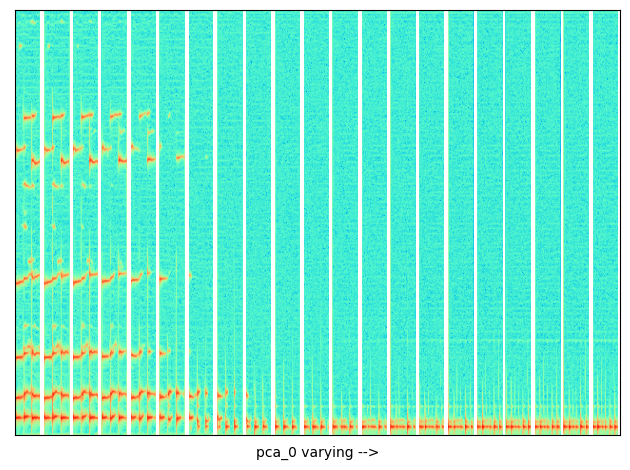

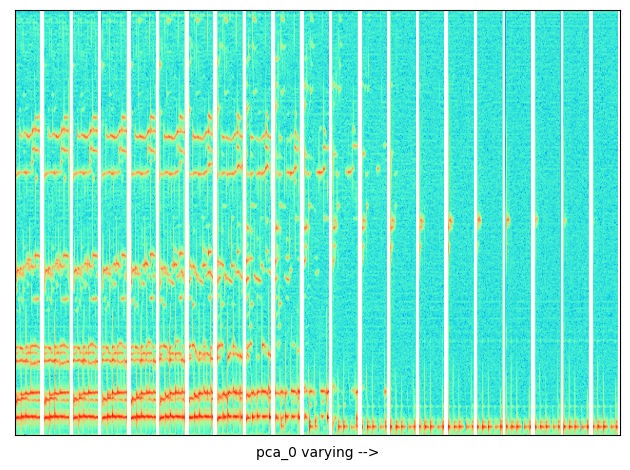

In [18]:
folders = ['audiofiles/varyComp0_initMetal_equispaced20','audiofiles/varyComp0_initWood_equispaced20']
sub = 'one_z_pitch_sweep'
run = 0
for folder in folders:
    print('Run ',run)
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,'pca_0')
    run = run+1
    

Component 0 indeed controls the class identity and transitions from one class to another. But the transition is very quick.
Later I also zoom into the central region where the transition happens. More of that in the "Untrained Scenarios" section below.

## Varying pca_1 conditioning dimension, choosing 'wood' class in pca_0

Run  0


Run  1


Run  2


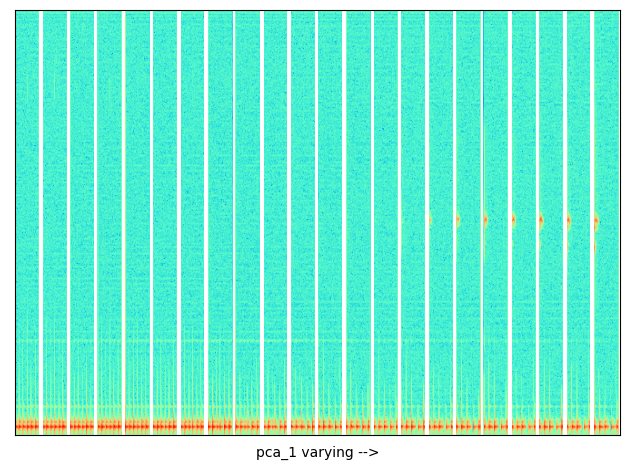

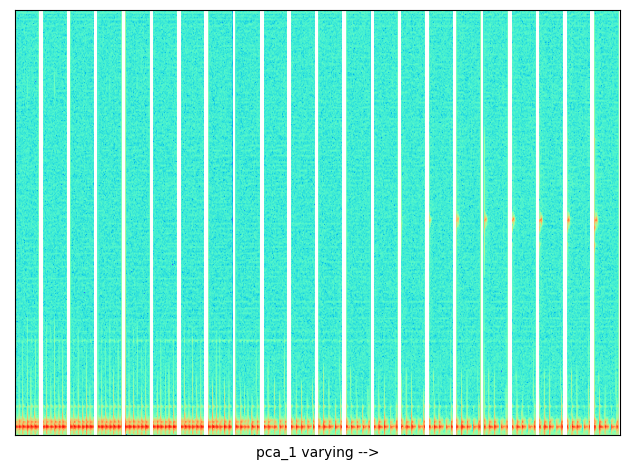

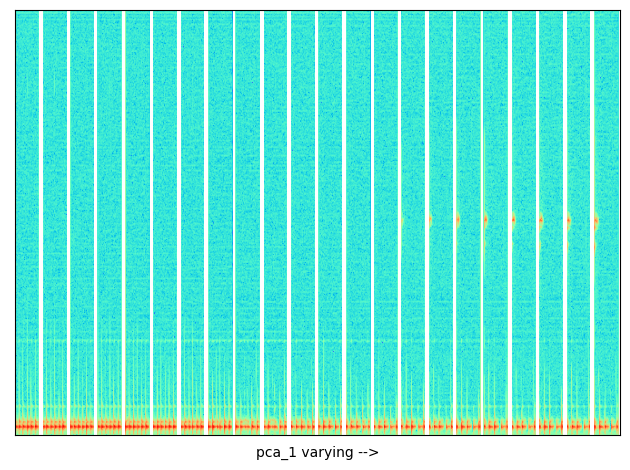

In [26]:
folders = ['audiofiles/varyComp1_initWood_equispaced20','audiofiles/varyComp1_initWood_equispaced20_v2','audiofiles/varyComp1_initWood_equispaced20_v3']
sub = 'one_z_pitch_sweep'
run = 0
for folder in folders:
    print('Run ',run)
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,'pca_1')
    run = run+1

Component 1 indeed increases the rate of wood taps (i.e. high to low) when pca_0 selects wood. Consistently there is a metal leak in the high values of pca_1. Why?

Run  0


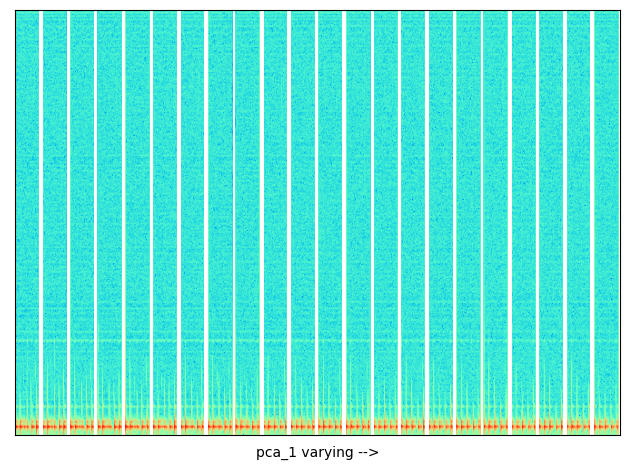

In [28]:
folders = ['audiofiles/varyComp1-0to11_initWood_equispaced20']#,'audiofiles/varyComp1_0to10_initWater_equispaced20']
sub = 'one_z_pitch_sweep'
run = 0
for folder in folders:
    print('Run ',run)
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,'pca_1')
    run = run+1

I zoomed into the blank region of component 1 dimension between 0 and 11 at steps of 0.5. The rate decreases slightly, which means it does learn to reduce the rate in that direction, even though those values were not present during training.

## Varying pca_2 conditioning dimension, choosing 'metal' class in pca_0

Run  0


Run  1


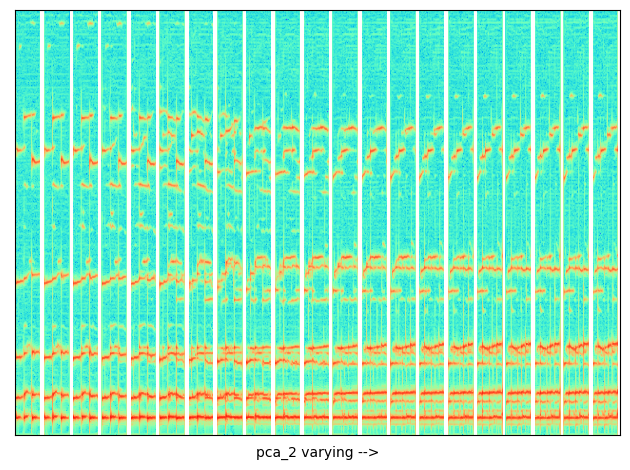

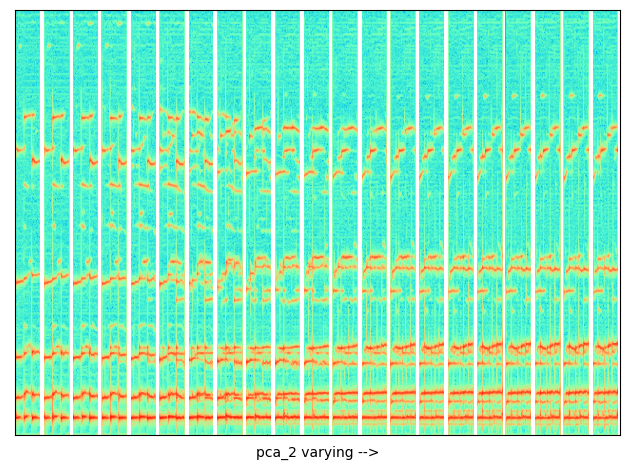

In [29]:
folders = ['audiofiles/varyComp2_initMetal_equispaced20','audiofiles/varyComp2_initMetal_equispaced20_v2']
sub = 'one_z_pitch_sweep'
run = 0
for folder in folders:
    print('Run ',run)
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,'pca_2')
    run = run+1

Component 2 indeed controls the parameter of wind class (i.e. stength) when pca_0 is selected as wind. The strength transitions actually sounds very interesting - the low to high strength pca dimension transition actually sounds like low to high wind strength transition, although the range is still not the complete range of strength in training data. This is probably because the GAN models an average values of strength level for each sub-range of pca_2 values

## Varying pca_1 conditioning dimension, choosing 'metal' class in pca_0 (UNTRAINED SCENARIO)

Now for regions of the cube that are unseen during training, we would like to see how the dimensions affect the generated sounds.

Run  0


Run  1


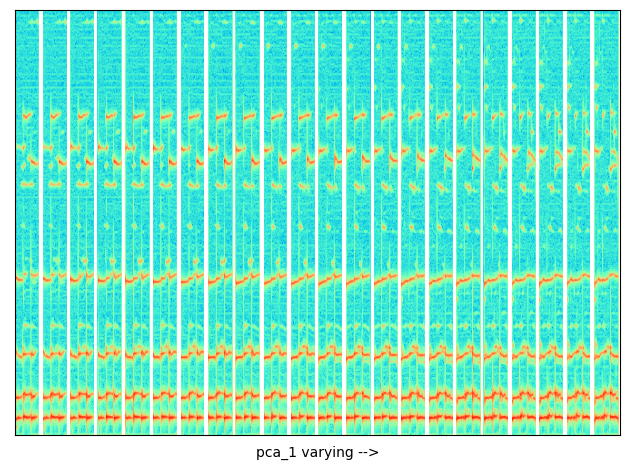

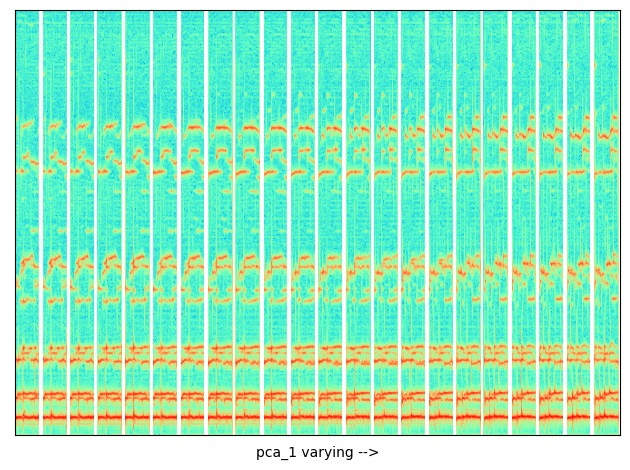

In [30]:
folders = ['audiofiles/untrained_directions/varyComp1_initMetal_equispaced20','audiofiles/untrained_directions/varyComp1_initMetal_equispaced20_v2']
sub = 'one_z_pitch_sweep'
run = 0
for folder in folders:
    print('Run ',run)
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,'pca_1')
    run = run+1

When metal is selected (by pca_0), and pca_1 (that corresponds to wood rate) is varied from lowest to highest point, interestingly the metal rate  slightly increases. Is this a learnt behavior? 

## Varying pca_2 conditioning dimension, choosing 'wood' class in pca_0 (UNTRAINED SCENARIO)

Run  0


Run  1


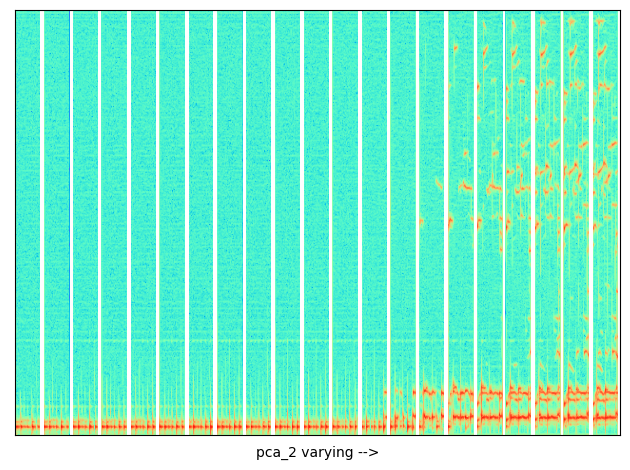

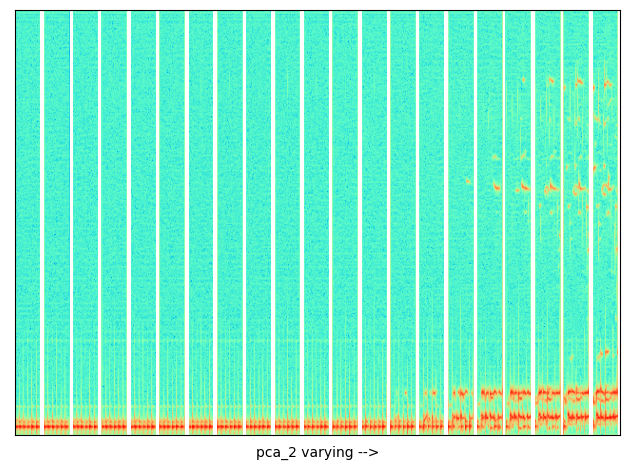

In [32]:
folders = ['audiofiles/untrained_directions/varyComp2_initWood_equispaced20','audiofiles/untrained_directions/varyComp2_initWood_equispaced20_v2']
sub = 'one_z_pitch_sweep'
run = 0
for folder in folders:
    print('Run ',run)
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,'pca_2')
    run = run+1

major leakage from the class direction when pca_2 is high

## Choosing [0,0,0] as the initial point, and varying in pca_0, pca_1, and pca2 directions (UNTRAINED SCENARIO) - RUN 0

pca_0


pca_1


pca_2


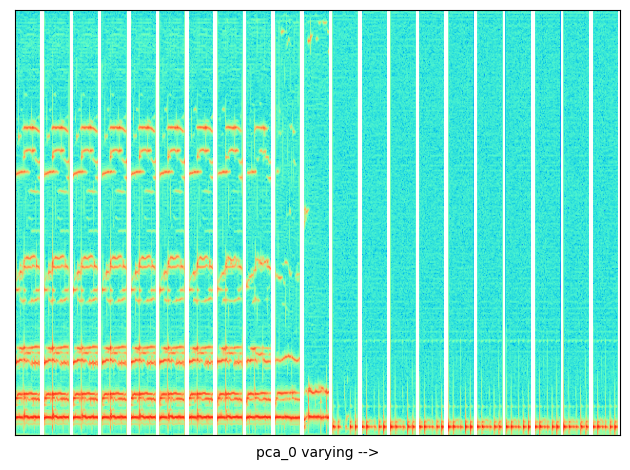

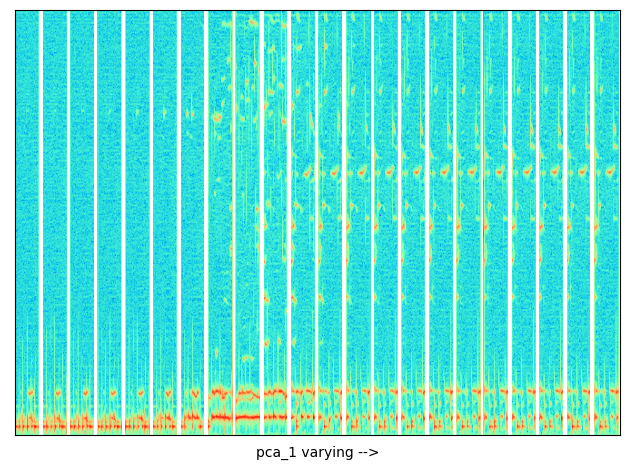

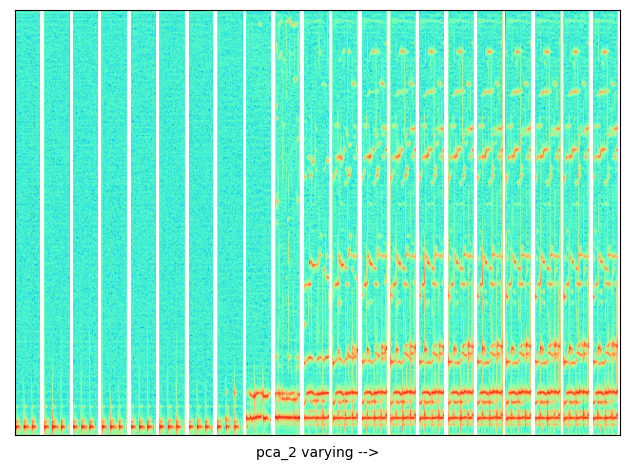

In [34]:
folders = ['audiofiles/untrained_directions/varyComp0_init0.0_equispaced20','audiofiles/untrained_directions/varyComp1_init0.0_equispaced20','audiofiles/untrained_directions/varyComp2_init0.0_equispaced20']
sub = 'one_z_pitch_sweep'
run = 0
pcas = ['pca_0','pca_1','pca_2']
for folder in folders:
    # print('Run ',run)
    print(pcas[run])
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,pcas[run])
    run = run+1

When the center of the cube (0,0,0) is selected, and individual dimensions are varied, again, interesting new sounds are observed.

## Choosing [0,0,0] as the initial point, and varying in pca_0, pca_1, and pca2 directions (UNTRAINED SCENARIO) - RUN 1

pca_0


pca_1


pca_2


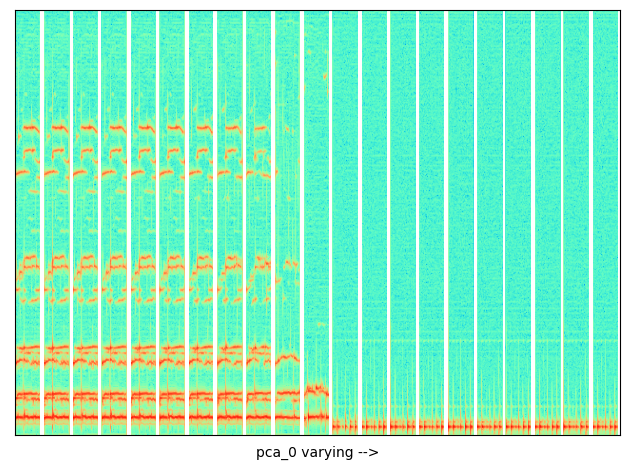

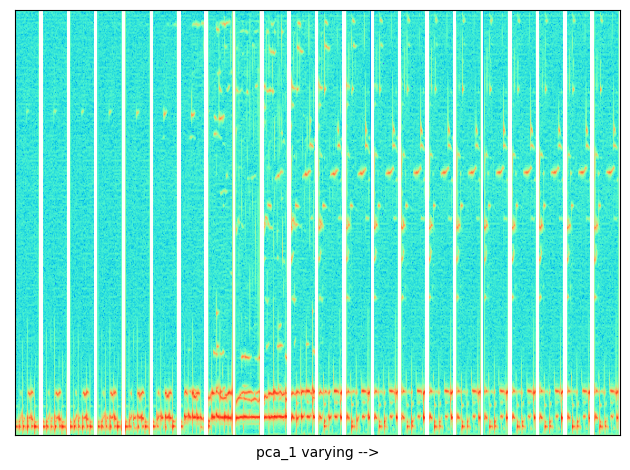

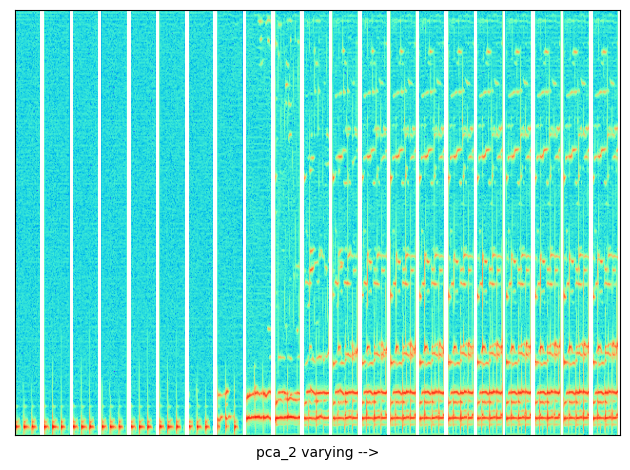

In [35]:
folders = ['audiofiles/untrained_directions/varyComp0_init0.0_equispaced20_v2','audiofiles/untrained_directions/varyComp1_init0.0_equispaced20_v2','audiofiles/untrained_directions/varyComp2_init0.0_equispaced20_v2']
sub = 'one_z_pitch_sweep'
run = 0
pcas = ['pca_0','pca_1','pca_2']
for folder in folders:
    # print('Run ',run)
    print(pcas[run])
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,pcas[run])
    run = run+1

## Choosing [0,0,0] as the initial point, and varying in pca_0 direction ZOOMING INTO THE CENTRAL TRANSITION REGION (-5 to 10) (UNTRAINED SCENARIO)

pca_0


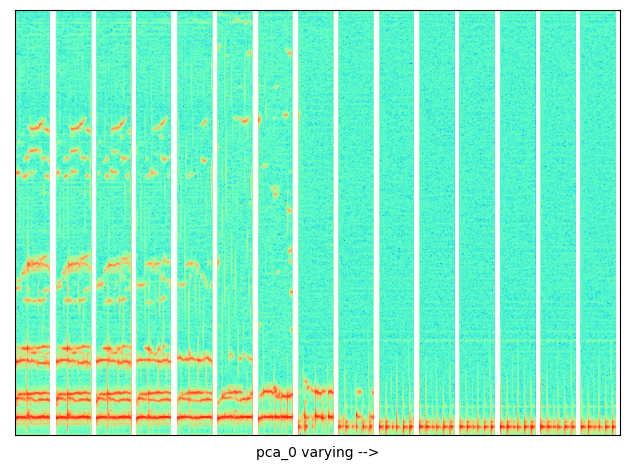

In [39]:
folders = ['audiofiles/untrained_directions/varyComp0_-5to10_init0.0_equispaced20'] #,'audiofiles/untrained_directions/varyComp1_-1to1_init0.0_equispaced20_v3','audiofiles/untrained_directions/varyComp2_-1to1_init0.0_equispaced20_v3']
sub = 'one_z_pitch_sweep'
run = 0
pcas = ['pca_0','pca_1','pca_2']
for folder in folders:
    # print('Run ',run)
    print(pcas[run])
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,pcas[run])
    run = run+1

This is the zoomed in case, where pca_0 variation is zoomed into just around the transition region. Its interesting to see how the higher frequency components are getting gradually deleted and arrive at the lower components of wood

pca_0


pca_1


pca_2


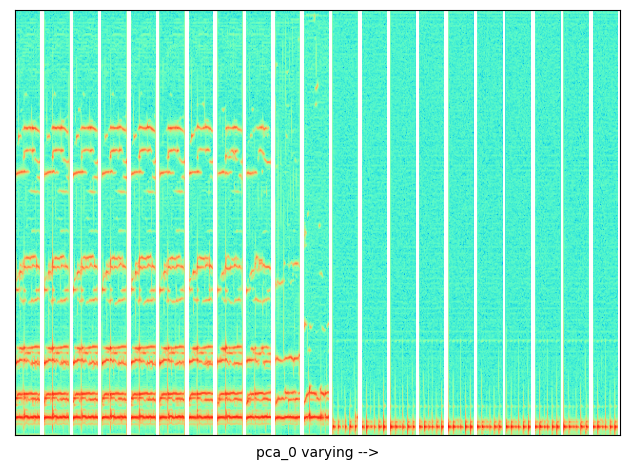

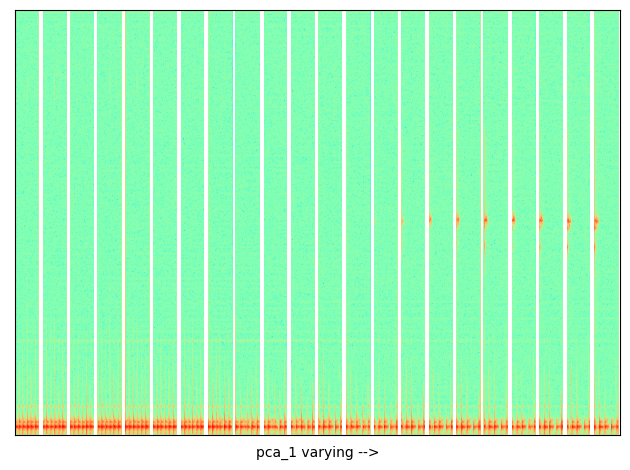

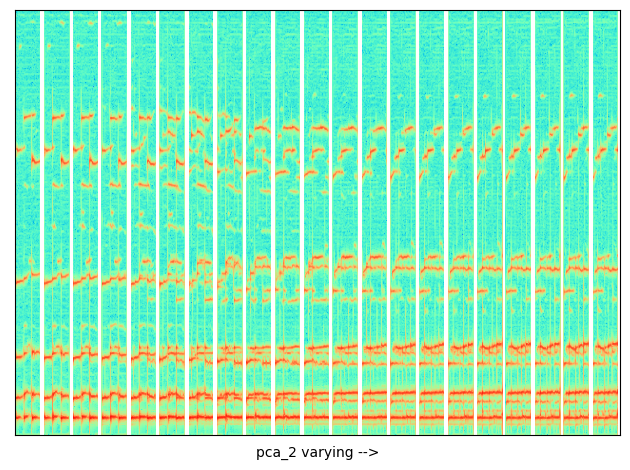

In [44]:
folders = ['audiofiles/varyComp0_init0_equispaced20_randomz','audiofiles/varyComp1_initWood_equispaced20_randomz','audiofiles/varyComp2_initMetal_equispaced20_randomz']
sub = 'one_z_pitch_sweep'
run = 0
pcas = ['pca_0','pca_1','pca_2']
for folder in folders:
    # print('Run ',run)
    print(pcas[run])
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,pcas[run])
    run = run+1